(The image above was created by expanding a visualization of the decision boundary made by the classifier described in this article after randomly selecting columns from a kernel matrix with a sinusoidal-esque kernel function, the full notebook replicating images of that type can be found here)

While not always useful, conceptualizing models, especially nonlinear, can give interesting results. I started thinking about how I would optimize parameters for an ellipsoid model. The first step is defining the model.

$f(x_i | w,  b, r) = \sum^{n}_{k = 1}{\frac{(x_{ik} - w_k)^2}{b_k^2}} - r^2$

where $x_i, w, b \in R^{n}$ and $r \in R$

Our actual prediction will be

$sign(f(x_i | w, b, r,))$

Meaning our support for $y_i$ is $\{-1, 1\}$.

Our objective will be hinge loss, we'll be using Stochastic Gradient Descent for optimization.

$loss(y_i, x_i | w, b, r) = max(0, 1 - y_i f(x_i))$

While I'm calling it a classifier, it works better for feature engineering and then training another model to find the best split. I'll be providing density plots of the model outputs as a way of visualizing separability.

In [319]:
using Zygote, MLJ, Plots, Images, LinearAlgebra, Statistics, StatsPlots
gr(size=(1200,600), dpi=600)

Plots.GRBackend()

We start by generating our data and transforming Y to fit with our support.

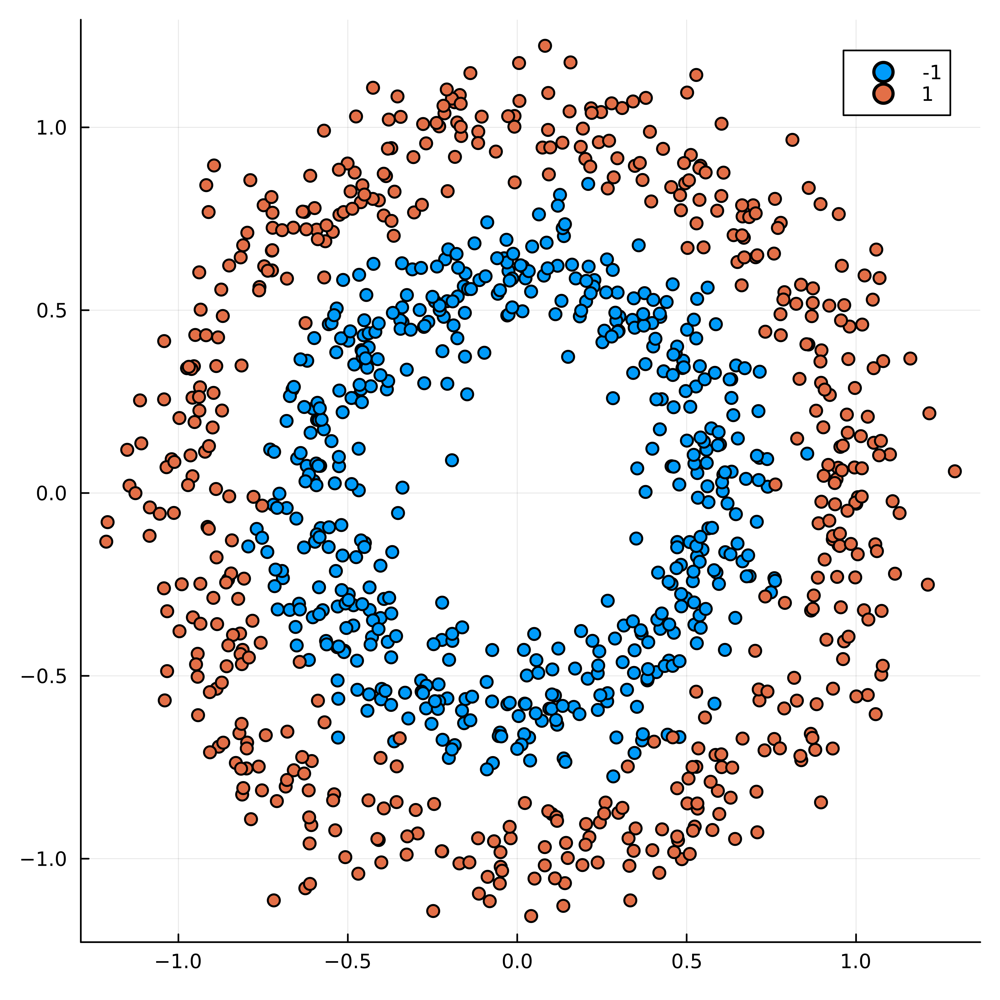

In [320]:
X, y = make_circles(1000, noise=.1, factor = .6, as_table = false)
Y = (2 * y .- 1)
gr(size=(600,600), dpi=600)
scatter(X[:, 1], X[:, 2], group = Y)

We define our model, our objective, and our gradients.

In [321]:
hyperellipsoid(w, b, x, r) = ((x .- w) .^ 2)'*(b .^ -2) - r
sgdloss(w, b, x, y, r) = max(0, 1 - hyperellipsoid(w, b, x, r) * y)
sgdgrad(w, b, x, y, r) = Zygote.gradient((w, b, r) -> sgdloss(w, b, x, y, r), w, b, r)

sgdgrad (generic function with 1 method)

We're ready to formulate our training loop, for this example program we'll also be recording the objective at each step to show that it converges to something.

In [322]:
function train(X, Y)
    w = mean(X[Y .== -1, :], dims = 1)[1, :]
    b = std(X[Y .== -1, :], dims = 1)[1, :] .+ 1e-5 # add a small constant to avoid division by zero
    r = 1
    losses = []
    for _ in 1:500
        push!(losses, sum(sgdloss(w, b, X[i, :], Y[i], r) for i in 1:size(X, 1)))
        i = rand(1:size(X, 1))
        x = X[i, :]
        y = Y[i]
        g = sgdgrad(w, b, x, y, r)
        w -= 0.01 * g[1]
        b -= 0.01 * g[2]
        r -= 0.01 * g[3]
    end
    w, b, r, losses
end

train (generic function with 1 method)

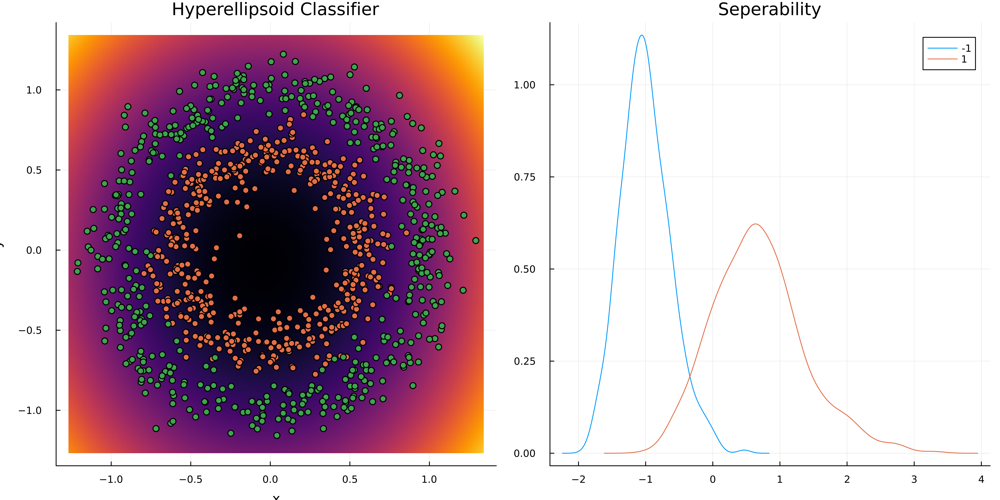

In [323]:
gr(size=(1200,600), dpi=600)
w, b, r, losses = train(X, Y)
l = @layout [a b]
# p1 = plot(1:size(losses, 1), losses, title = "Loss over Iterations", xlabel = "Iteration", ylabel = "Loss", legend = false)
p1 = density([hyperellipsoid(w, b, X[i, :], r) for i in 1:size(X, 1)], group = Y, title = "Seperability")
I = (minimum(X) .- .05):.01:(maximum(X) + .05)
data = [hyperellipsoid(w, b, [j; i], r) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Hyperellipsoid Classifier", xlabel = "x", ylabel = "y", legend = false, size=(400, 400))
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

For reference, a quick logistic regression would make predictions like this.

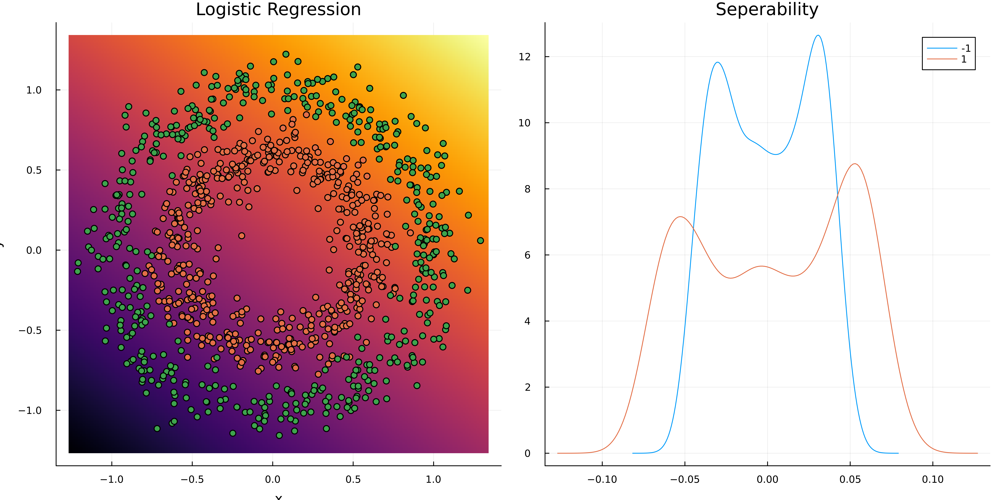

In [324]:
sigmoid(x) = 1 / (1 + exp(-x))
ay = (Y .+ 1)./2
m = pinv(X) * ay
p1 = density([m' * X[i, :] for i in 1:size(X, 1)], group = Y, title = "Seperability")
data = [sigmoid(m' * [i; j]) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Logistic Regression", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

The model performs well on data that's ellipsoidal, big whoop right? How about data that is clearly not.

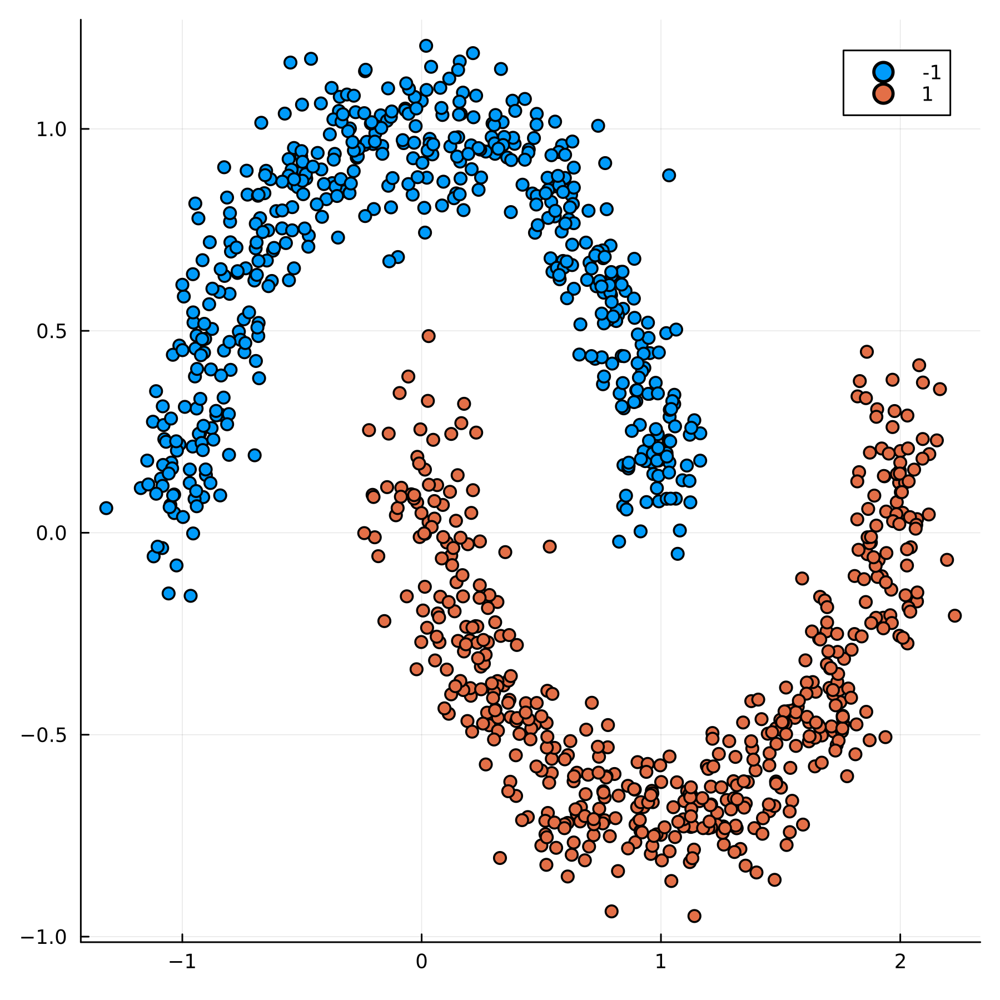

In [325]:
gr(size=(600,600), dpi=300)
X, Y = make_moons(1000, noise=0.1, as_table = false)
Y = (2 * Y .- 1)
scatter(X[:, 1], X[:, 2], group = Y)

For reference

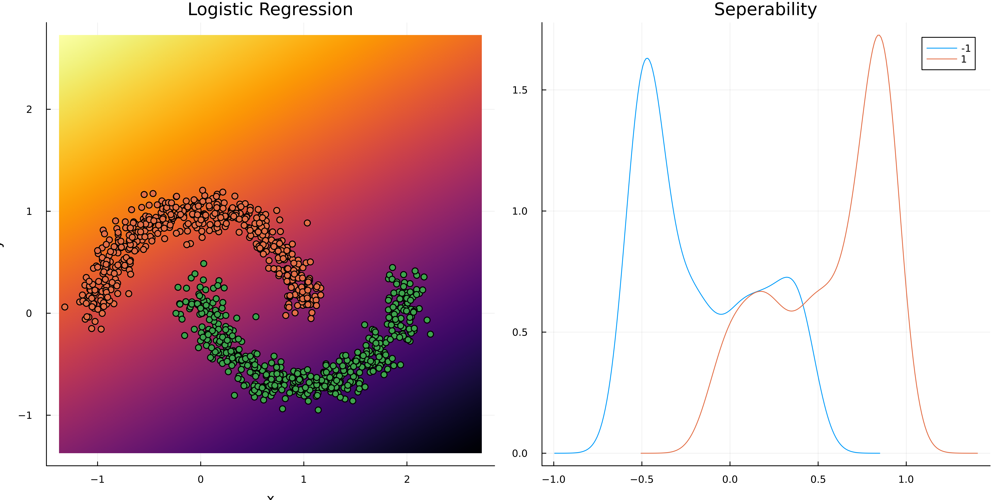

In [335]:
gr(size=(1200,600), dpi=600)
ay = (Y .+ 1)./2
I = (minimum(X) - .05):.01:(maximum(X) + .5)
m = pinv(X) * ay
p1 = density([m' * X[i, :] for i in 1:size(X, 1)], group = Y, title = "Seperability")
data = [sigmoid(m' * [i; j]) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Logistic Regression", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

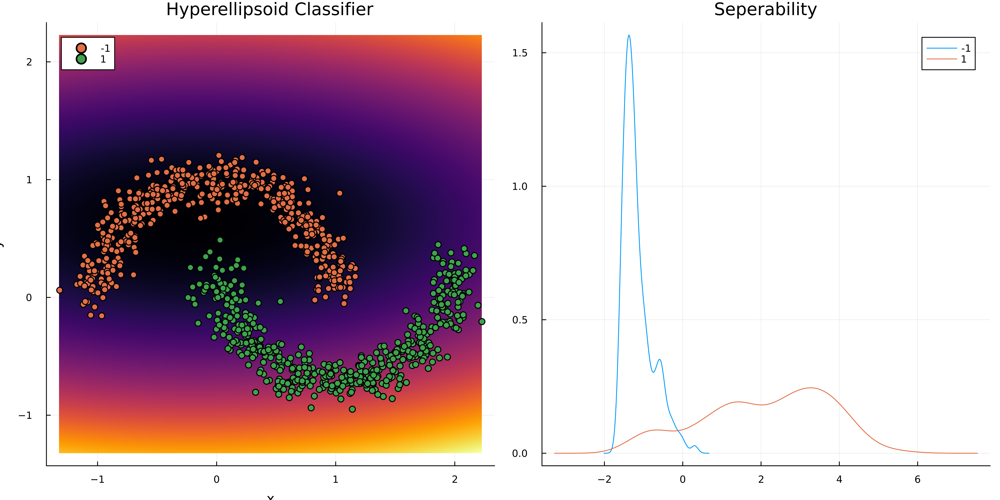

In [327]:
w, b, r, losses = train(X, Y)
# p1 = plot(1:size(losses, 1), losses, title = "Loss over Iterations", xlabel = "Iteration", ylabel = "Loss", legend = false)
p1 = density([hyperellipsoid(w, b, X[i, :], r) for i in 1:size(X, 1)], group = Y, title = "Seperability")
I = minimum(X):.01:maximum(X)
data = [hyperellipsoid(w, b, [j; i], r) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Hyperellipsoid Classifier", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y, legend = true)
plot(p3, p1, layout = l)

Can't work miracles here. It's still modeling an ellipse, but what if we used some feature engineering. Let's first try augmenting the dataset.

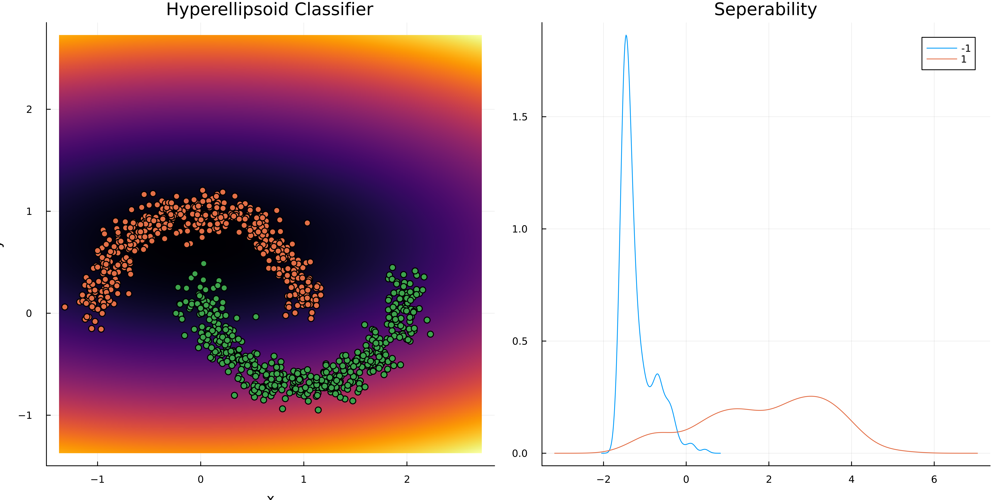

In [328]:
w, b, r, losses = train([X ones(size(X, 1))], Y)
# p1 = plot(1:size(losses, 1), losses, title = "Loss over Iterations", xlabel = "Iteration", ylabel = "Loss", legend = false)
p1 = density([hyperellipsoid(w, b, [X[i, :]; 1], r) for i in 1:size(X, 1)], group = Y, title = "Seperability")
I = (minimum(X) - .05):.01:(maximum(X) + .5)
data = [hyperellipsoid(w, b, [j; i; 1], r) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Hyperellipsoid Classifier", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

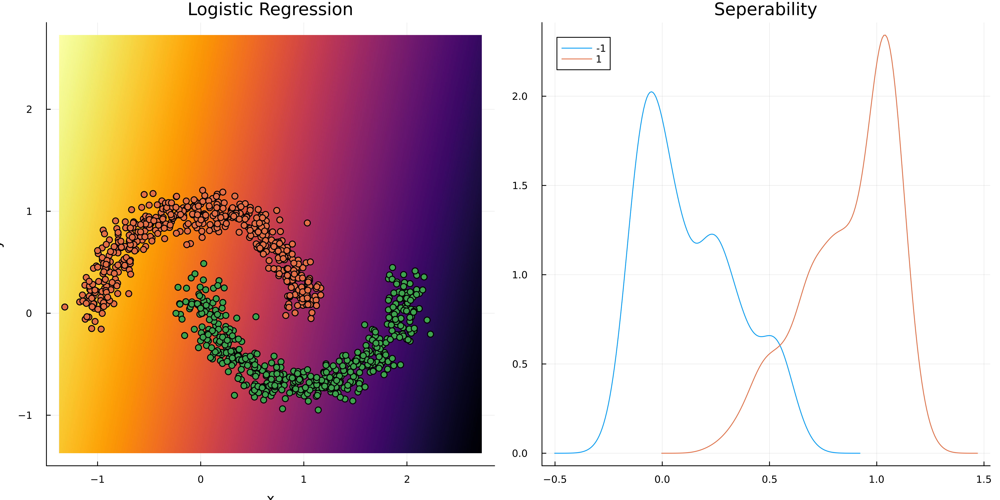

In [329]:
m = pinv([X ones(size(X, 1))]) * ay
p1 = density([m' * [X[i, :]; 1] for i in 1:size(X, 1)], group = Y, title = "Seperability")
data = [sigmoid(m' * [i; j; 1]) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Logistic Regression", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

Didn't change too much, let's try fitting on the kernel matrix.

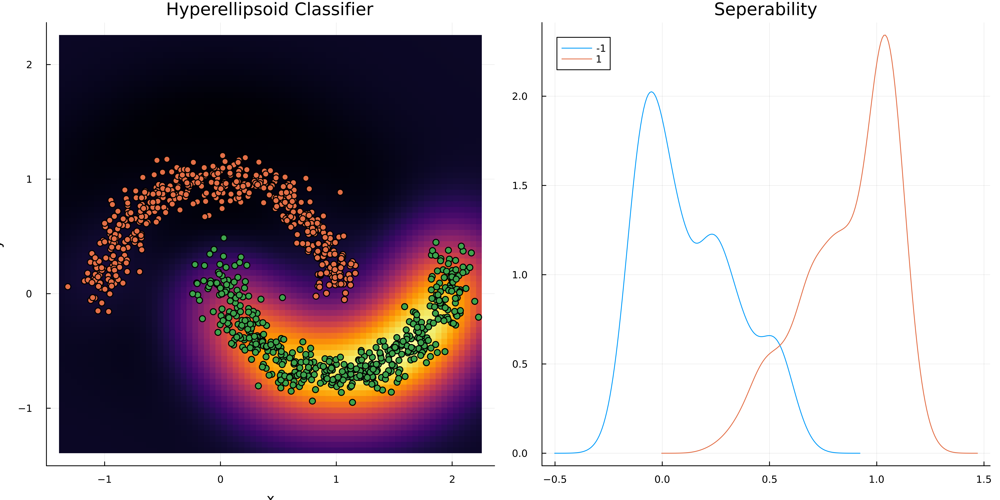

In [330]:
kern(x, y) = exp(-norm(x - y)^2/.5)
K = [kern(X[i, :], X[j, :]) for i in 1:size(X, 1), j in 1:size(X, 1)]
w, b, r, losses = train(K, Y)
# p1 = plot(1:size(losses, 1), losses, title = "Loss over Iterations", xlabel = "Iteration", ylabel = "Loss", legend = false)
# p1 = scatter([hyperellipsoid(w, b, K[i, :], r) for i in 1:size(X, 1)], Y, group = Y, title = "Seperability", xlabel = "x", ylabel = "y", legend = false)
density([hyperellipsoid(w, b, [hyperellipsoid(w, b, K[i, :], r) for i in 1:size(X, 1)], r) for i in 1:size(X, 1)], group = Y, title = "Seperability")
I = (minimum(X) - .05):.05:(maximum(X) + .05)
data = [hyperellipsoid(w, b, [kern([j; i], X[k, :]) for k in 1:size(X, 1)], r) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Hyperellipsoid Classifier", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

Pseudo inverse falters with the kernel matrix, we'll fit a logistic regression with SGD instead.

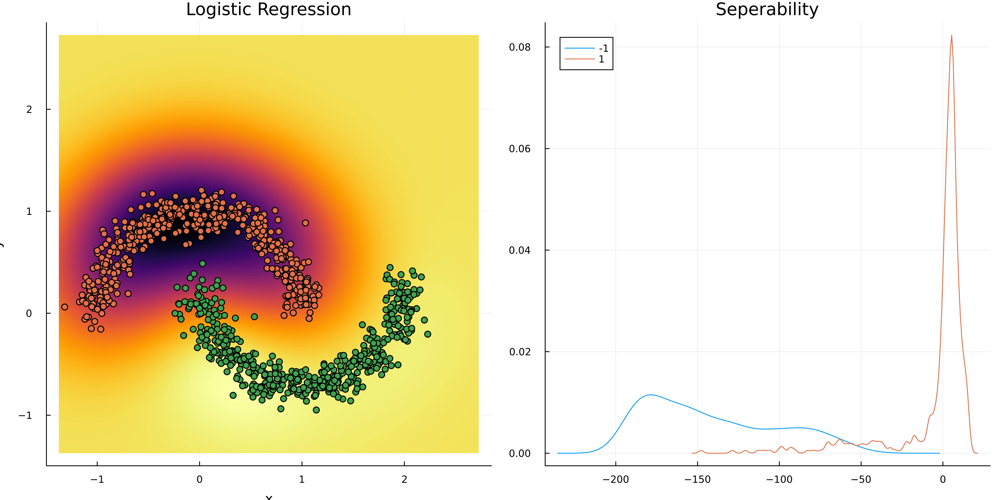

In [338]:
m = zeros(size(X, 1))
cross_entropy(m, x, y) = -y*log(sigmoid(m' * x)) - (1 - y)*log(1 - sigmoid(m' * x))
for _ in 1:500
    i = rand(1:size(X, 1))
    y = Y[i]
    x = K[i, :]
    m .-= .01 * (sigmoid(m' * x) - y) * x
end
p1 = density([m' * K[i, :] for i in 1:size(X, 1)], group = Y, title = "Seperability")
data = [m' * [kern([j; i], X[k, :]) for k in 1:size(X, 1)] for i in I, j in I]
p2 = heatmap(I, I, data, title = "Logistic Regression", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y)
plot(p3, p1, layout = l)

For toy problems like these, we expect linear methods with kernels like the rbf kernel to be more than enough to find some solution. We should expect our ellipsoid model, with about 2 times the amount of parameters to outperform our linear model. However, not only does it underperform against the kernalized logistic regression, it nearly underperforms the nonkernalized version, It's important to recognize how the constraints we've put on the problem. Expanding our model definition, we can represent the model as a linear combination.

$\sum_{k = 1}^{n}{\frac{x^2}{b^2} + \frac{w x}{b^2} + \frac{w^2}{b^2}}$

We can view the possible models generated by these coefficients as a subset of quadratic models. There exists some quadratic model that performs at least as well as our hyper ellipsoid model. This makes sense, ellipsoids are a subset of quadratic surfaces. But why would a purely linear combination of rbf features outperform our model? I can only give a good guess, with the existing dimensionality of the kernel matrix most likely negates most of the benefits of a quadratic model. The constraints presented serve only to hinder the ability of the model to classify the data. The output of each term of our original model has to be positive except for r. The effect of each feature can only increase the probability a point is not in the model. However, we still gain a level of interpretability from the ellipsoid model that we don't get from a linear model on this kernel. It might be tempting to think of the classifier as pushing w towards the mean and b towards the standard deviation of the features. In the case with the circles dataset this is probably true, but revisiting the non kernelized moon dataset.

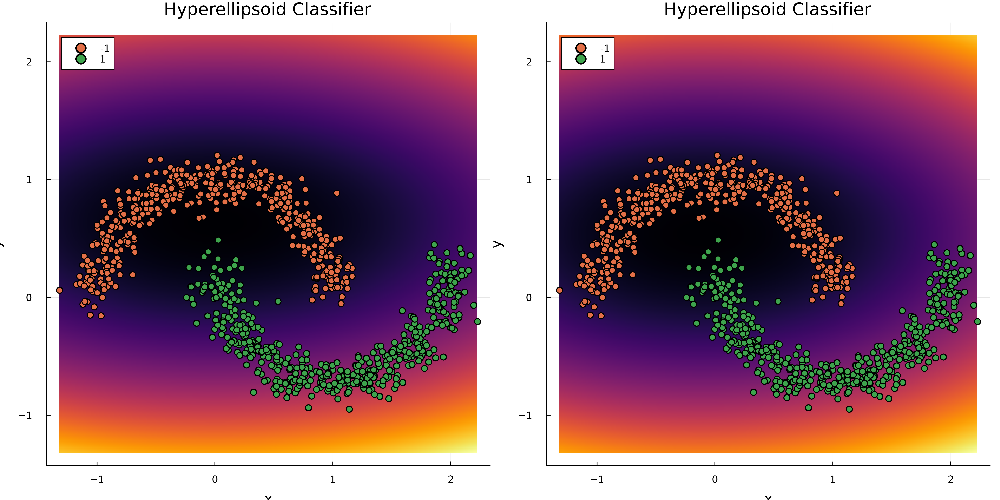

In [332]:
w0, b0 = mean(X[Y .== -1, :], dims = 1)[1, :], std(X[Y .== -1, :], dims = 1)[1, :] .+ 1e-5
l2 = @layout [a b]
# p1 = plot(1:size(losses, 1), losses, title = "Loss over Iterations", xlabel = "Iteration", ylabel = "Loss", legend = false)
I = minimum(X):.01:maximum(X)
data = [hyperellipsoid(w0, b0, [j; i], 1) for i in I, j in I]
p2 = heatmap(I, I, data, title = "Hyperellipsoid Classifier", xlabel = "x", ylabel = "y", legend = false)
p3 = scatter!(X[:, 1], X[:, 2], group = Y, legend = true)
w, b, r, losses = train(X, Y)
data = [hyperellipsoid(w, b, [j; i], r) for i in I, j in I]
p4 = heatmap(I, I, data, title = "Hyperellipsoid Classifier", xlabel = "x", ylabel = "y", legend = false)
p5 = scatter!(X[:, 1], X[:, 2], group = Y, legend = true)
plot(p3, p5, layout = l2)
# p3

In [333]:
w, w0

([-0.10632215677078599, 0.5403779865767874], [0.005786121327004616, 0.6335680180676206])

In [334]:
b , b0

([1.5418737463002261, 0.7714350788136385], [0.7158480275760287, 0.3262219708615116])

In the training function, we use the column-wise mean and standard deviation as the initial variables. The initial plot can be seen in the image above to the right and post-training on the left. There is a subtle difference here, while the w generally stays near the mean, b does not stay near the standard deviation. While we expect the center of the hyper-ellipsoid to be near the center of the cluster, b represents the half-axis lengths of the ellipsoid. While we might expect b to follow column-wise standard deviation, I can't see a guarantee of near equivalence. These axis lengths take into account the spread of other classes.